# GAN para sintetizar imágenes de lesiones cutáneas

En las siguientes celdas, diseñaremos y entrenaremos nuestra propia GAN, para poder así generar imágenes similares a las de nuestro dataset y evaluar sus resultados.

In [1]:
from typing import List, Dict, Tuple, Any
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense,Dropout, Reshape, BatchNormalization, LeakyReLU, Input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from keras.backend import clear_session

2024-11-29 09:24:09.825048: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-29 09:24:09.830638: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-29 09:24:09.848821: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1732883049.874733   55933 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1732883049.880507   55933 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-29 09:24:09.901540: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU ins

In [ ]:
# Load the dataset from dataset.npz
dataset_dir = './'
dataset_path = os.path.join(dataset_dir, 'dataset.npz')
print('Loading dataset...')
data = np.load(dataset_path)
images = data['images']
del data

# Reshape images to 128x128x3
print('Reshaping images...')
images = np.array([
        cv2.resize(image, (128, 128)) for image in images
    ])
print('Dataset loaded')

Loading dataset...


In [3]:
def normalize_image(img: np.ndarray) -> np.ndarray:
    """
    Normalize images to floats in the range [-1, 1]
    """
    return img / 127.5 - 1.0


def recenter_rescale_image(img: np.ndarray) -> np.ndarray:
    """
    Denormalize the image, inverse of above function
    """
    return ((img + 1) * 127.5).astype(np.uint8)

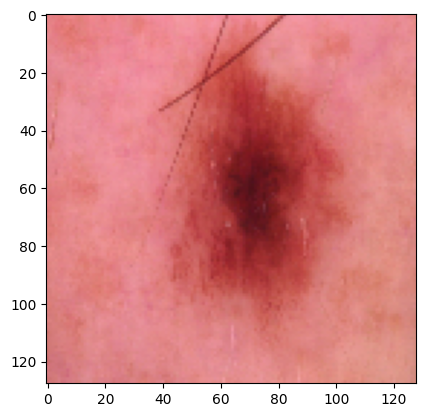

In [4]:
images = normalize_image(images)
plt.imshow(recenter_rescale_image(images[0]))
plt.show()


## Implementación de GANs para Generación de Imágenes Médicas

Construcción de una GAN básica para generar imágenes médicas.

In [5]:
latent_dim = 100
learning_rate = 0.0002

# Build Generator
def build_generator():
    model = Sequential([
        Dense(128, input_dim=latent_dim),
        LeakyReLU(0.2),
        BatchNormalization(momentum=0.8),
        Dense(512),
        LeakyReLU(0.2),
        BatchNormalization(momentum=0.8),
        Dense(128 * 128 * 3, activation='tanh'),
        Reshape((128, 128, 3))
    ])
    return model

# Build Discriminator
def build_discriminator():
    model = Sequential([
        Conv2D(64, (3, 3), padding='same', input_shape=(128, 128, 3)),
        LeakyReLU(alpha=0.2),
        MaxPooling2D(pool_size=(2, 2)),
        Conv2D(128, (3, 3), padding='same'),
        LeakyReLU(alpha=0.2),
        MaxPooling2D(pool_size=(2, 2)),
        Conv2D(128, (3, 3), padding='same'),
        LeakyReLU(alpha=0.2),
        MaxPooling2D(pool_size=(2, 2)),
        Conv2D(256, (3, 3), padding='same'),
        LeakyReLU(alpha=0.2),
        MaxPooling2D(pool_size=(2, 2)),
        Flatten(),
        Dense(1, activation='sigmoid')
    ])
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate, 0.5), metrics=['accuracy'])
    return model

def build_gan(generator, discriminator):
    model = Sequential([generator, discriminator])
    model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate, 0.5))
    return model


# Build and compile models
generator = build_generator()
discriminator = build_discriminator()
gan = build_gan(generator, discriminator)

/opt/conda/lib/python3.10/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/opt/conda/lib/python3.10/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [6]:
generator.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 128)            │        12,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 512)            │        66,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 49152)          │    25,214,976 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 128, 128, 3)    │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 25,296,512 (96.50 MB)

 Trainable params: 25,295,232 (96.49 MB)

 Non-trainable params: 1,280 (5.00 KB)

In [7]:
discriminator.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 128, 128, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 64, 64, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 32, 32, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 16384)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │        16,385 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 534,785 (2.04 MB)

 Trainable params: 534,785 (2.04 MB)

 Non-trainable params: 0 (0.00 B)

In [8]:
gan.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential (Sequential)         │ ?                      │    25,296,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_1 (Sequential)       │ ?                      │       534,785 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 25,831,297 (98.54 MB)

 Trainable params: 25,830,017 (98.53 MB)

 Non-trainable params: 1,280 (5.00 KB)

In [9]:
if not os.path.exists('gan_figures'):
    os.mkdir('gan_figures')

In [10]:
def show_generated_images(generator, epoch, grid_size=5):
    """
    Save a grid of generated images to visualize the progress.
    """
    noise = np.random.normal(0, 1, (grid_size**2, latent_dim))
    generated_images = generator.predict(noise, verbose=0)
    generated_images = recenter_rescale_image(generated_images)

    fig, axs = plt.subplots(grid_size, grid_size, figsize=(10, 10))
    cnt = 0
    for i in range(grid_size):
        for j in range(grid_size):
            axs[i, j].imshow(generated_images[cnt])
            axs[i, j].axis('off')
            # 
            cnt += 1
    plt.suptitle(f'{epoch=}')
    plt.tight_layout()
    plt.show()
    plt.savefig(f'gan_figures/epoch_{epoch}.png')
    plt.clf()
    plt.close()
    cv2.imwrite(f'gan_figures/epoch_{epoch}.png', generated_images[0])

I0000 00:00:1732848566.704979      73 service.cc:145] XLA service 0x7ea9a80102f0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1732848566.705029      73 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1732848566.705034      73 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1732848567.412997      73 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


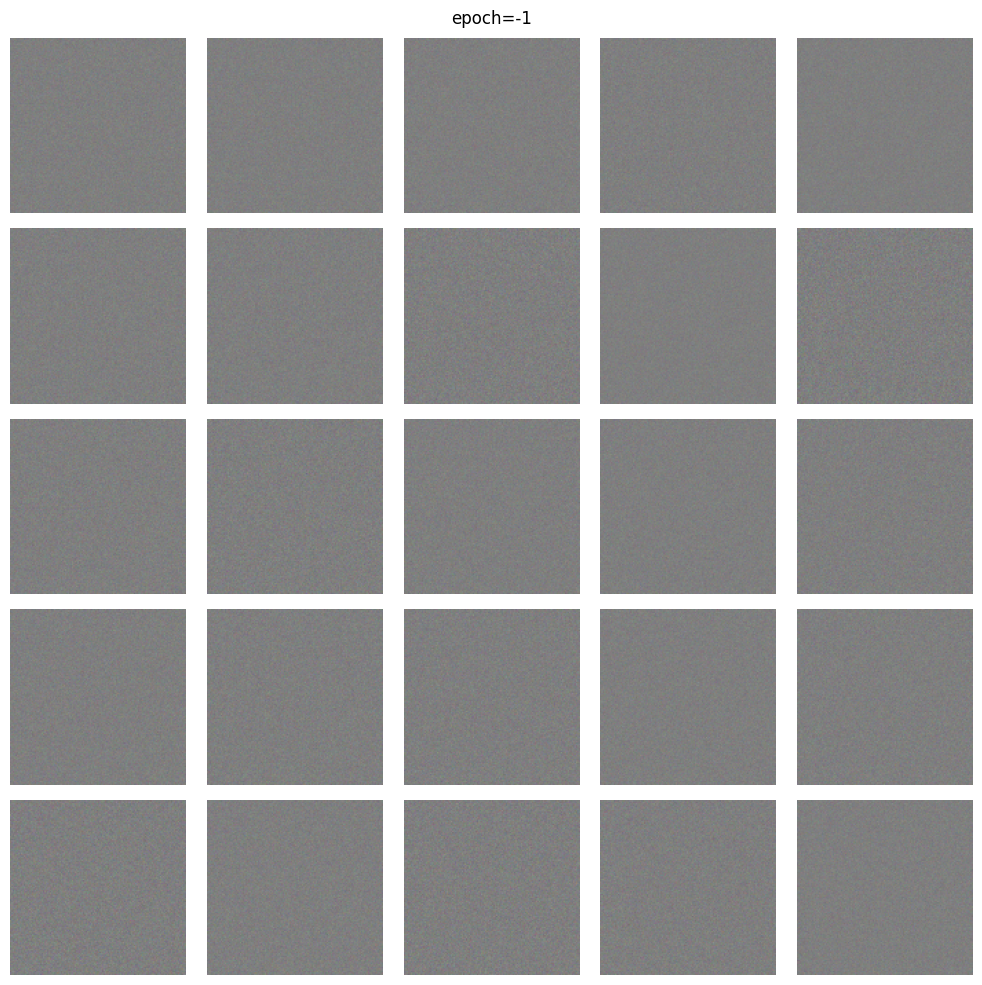

In [11]:
show_generated_images(build_generator(), -1)

### Entrenamiento de GAN

In [12]:
# Función de entrenamiento para la GAN
def train_gan(generator, discriminator, gan, epochs=10000, batch_size=32, latent_dim=100):
    """
    Train GAN by first training the discriminator to differentiate between
    real and synthetic, then freezing the discriminator and train the 
    generator to generate better synthetic images
    """
    for epoch in range(epochs):
        # --- Paso 1: Entrenar el Discriminador ---
        # Generar muestras reales y etiquetas correspondientes (1s para reales)
        idx = np.random.randint(0, images.shape[0], batch_size)
        real_images = images[idx]
        real_labels = np.ones((batch_size, 1))

        # Generar muestras falsas (imágenes generadas) y etiquetas correspondientes (0s para falsas)
        noise = np.random.normal(0, 1, (batch_size, latent_dim))  # Vector de ruido
        fake_images = generator.predict(noise, verbose=0)  # Generar imágenes falsas
        fake_labels = np.zeros((batch_size, 1))

        # Entrenar el discriminador en imágenes reales y falsas
        discriminator.trainable = True
        d_loss_real = discriminator.train_on_batch(real_images, real_labels)  # Entrena con imágenes reales
        d_loss_fake = discriminator.train_on_batch(fake_images, fake_labels)  # Entrena con imágenes falsas

        # Calcular la pérdida total del discriminador
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

        # --- Paso 2: Entrenar el Generador ---
        # Para entrenar el generador, generamos un nuevo lote de ruido y etiquetas        
        noise = np.random.normal(0, 1, (batch_size, latent_dim))
        misleading_labels = np.ones((batch_size, 1))

        # Entrenar el generador (a través del modelo GAN, donde el discriminador está congelado)
        discriminator.trainable = False
        g_loss = gan.train_on_batch(noise, misleading_labels)

        # --- Visualización y registro de la pérdida ---
        if epoch % 50 == 0:  # Resetear cada 50 epocas
            print(f"Epoch: {epoch}, D Loss: {d_loss[0]}, G Loss: {g_loss[0].item()}")
            # Mostrar cada 100
            if epoch % 100 == 0:
                show_generated_images(generator, epoch, grid_size=5) 
            
            # Save and restore weights periodically to free up memory
            generator.save_weights('generator.weights.h5')
            discriminator.save_weights('discriminator.weights.h5')

            clear_session()

            # Rebuild models
            generator = build_generator()
            discriminator = build_discriminator()

            # Reload weights
            generator.load_weights('generator.weights.h5')
            discriminator.load_weights('discriminator.weights.h5')
            gan = build_gan(generator, discriminator)

            print('Running some more epochs...')

            # Print memory usage for debugging
            memory_usage_GPU = tf.config.experimental.get_memory_info('GPU:0')['current']
            if memory_usage_GPU > 12.0e9:
                print('Early stopping for memoru limitations')
            print(f"Memory usage for GPU: {memory_usage_GPU/1e9:.3f} GB")

Epoch: 0, D Loss: 0.7011816501617432, G Loss: 0.705145001411438


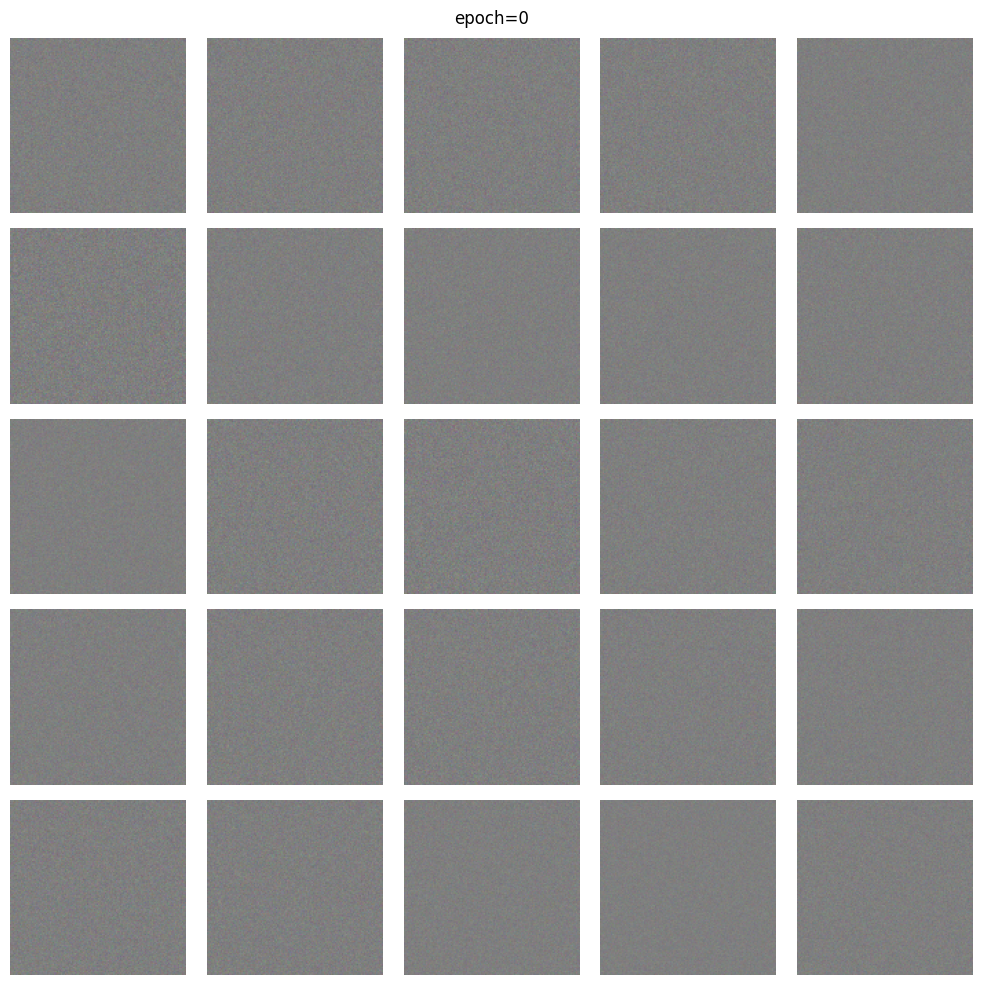

/opt/conda/lib/python3.10/site-packages/keras/src/saving/saving_lib.py:415: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 22 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Running some more epochs...
Memory usage for GPU: 0.414 GB
Epoch: 50, D Loss: 0.08903232216835022, G Loss: 0.08918473869562149
Running some more epochs...
Memory usage for GPU: 0.725 GB
Epoch: 100, D Loss: 0.051873400807380676, G Loss: 0.05187215283513069


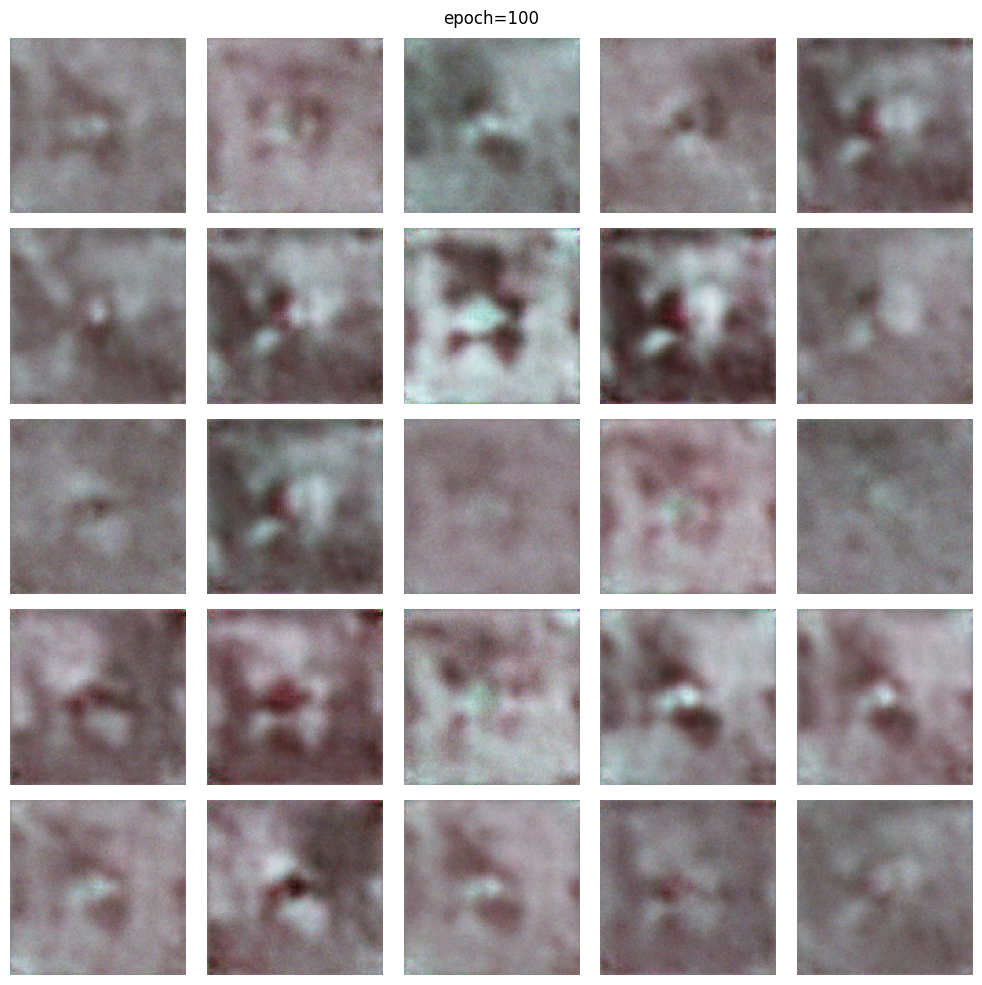

Running some more epochs...
Memory usage for GPU: 1.036 GB
Epoch: 150, D Loss: 0.08035147190093994, G Loss: 0.08011229336261749
Running some more epochs...
Memory usage for GPU: 1.449 GB
Epoch: 200, D Loss: 0.09142902493476868, G Loss: 0.09190399199724197


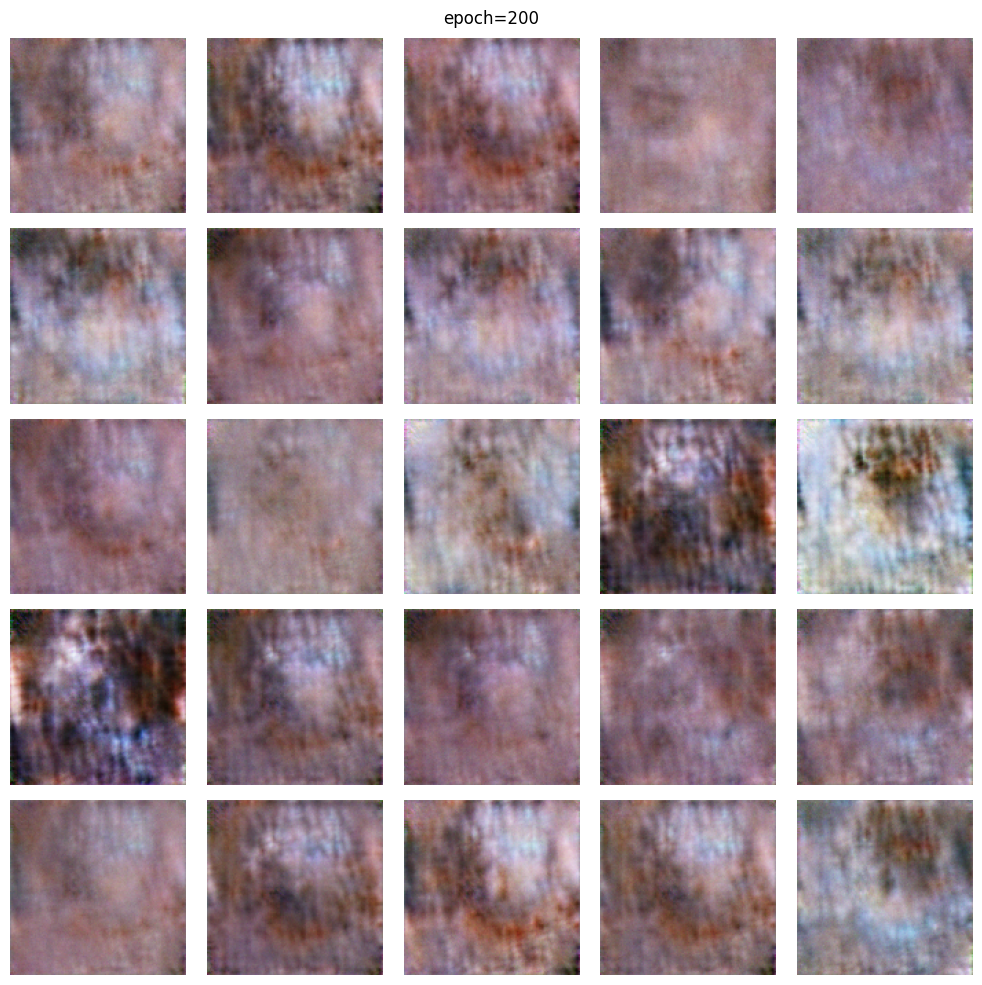

Running some more epochs...
Memory usage for GPU: 1.766 GB
Epoch: 250, D Loss: 0.17942845821380615, G Loss: 0.17989547550678253
Running some more epochs...
Memory usage for GPU: 2.092 GB
Epoch: 300, D Loss: 0.292031466960907, G Loss: 0.2916867136955261


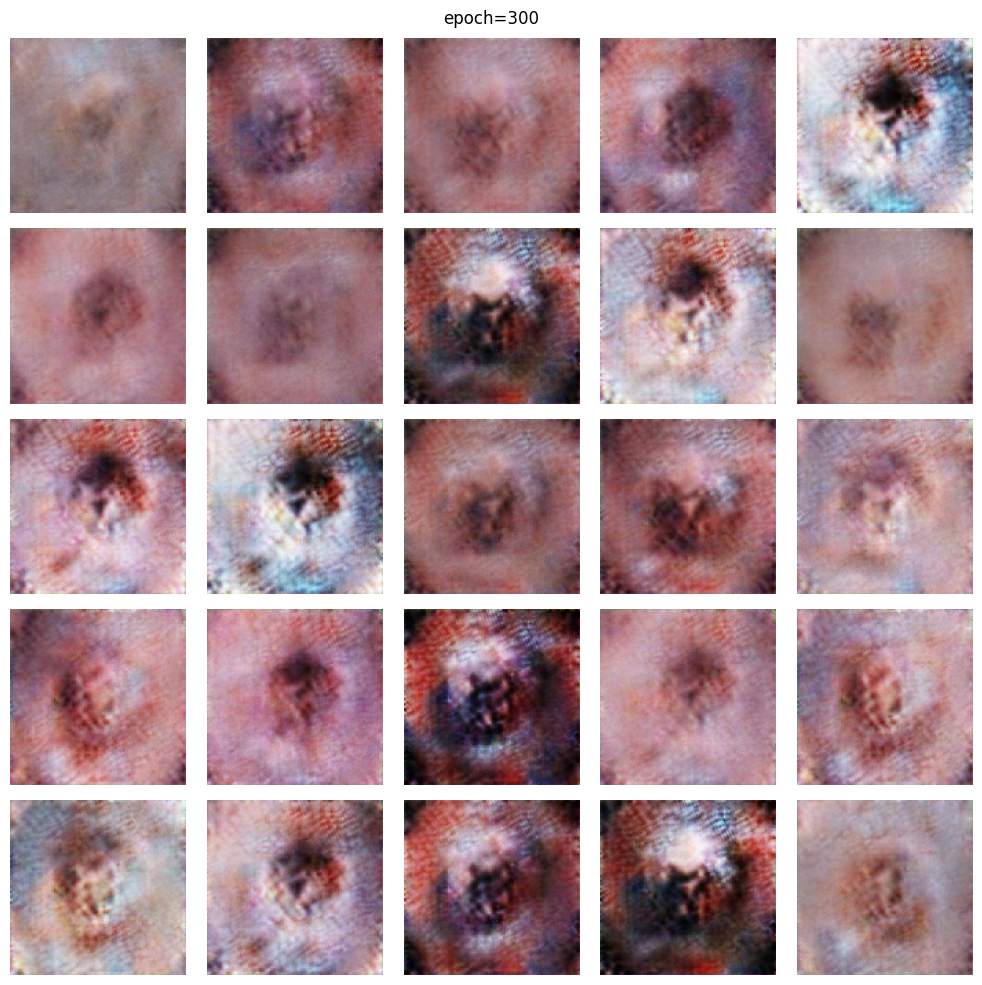

Running some more epochs...
Memory usage for GPU: 2.403 GB
Epoch: 350, D Loss: 0.3444005250930786, G Loss: 0.3439503312110901
Running some more epochs...
Memory usage for GPU: 2.719 GB
Epoch: 400, D Loss: 0.4485844373703003, G Loss: 0.4480549991130829


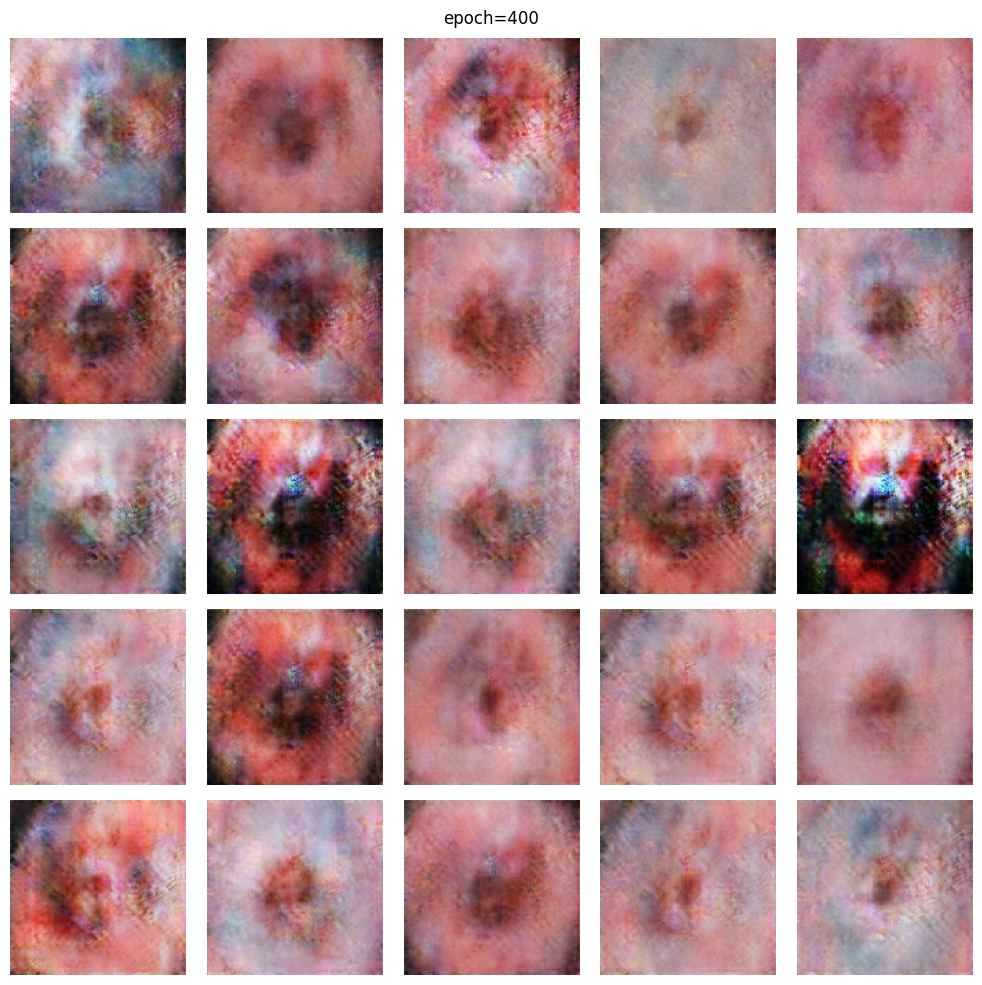

Running some more epochs...
Memory usage for GPU: 3.029 GB
Epoch: 450, D Loss: 0.5113557577133179, G Loss: 0.5109246969223022
Running some more epochs...
Memory usage for GPU: 3.340 GB
Epoch: 500, D Loss: 0.5921857357025146, G Loss: 0.5918152332305908


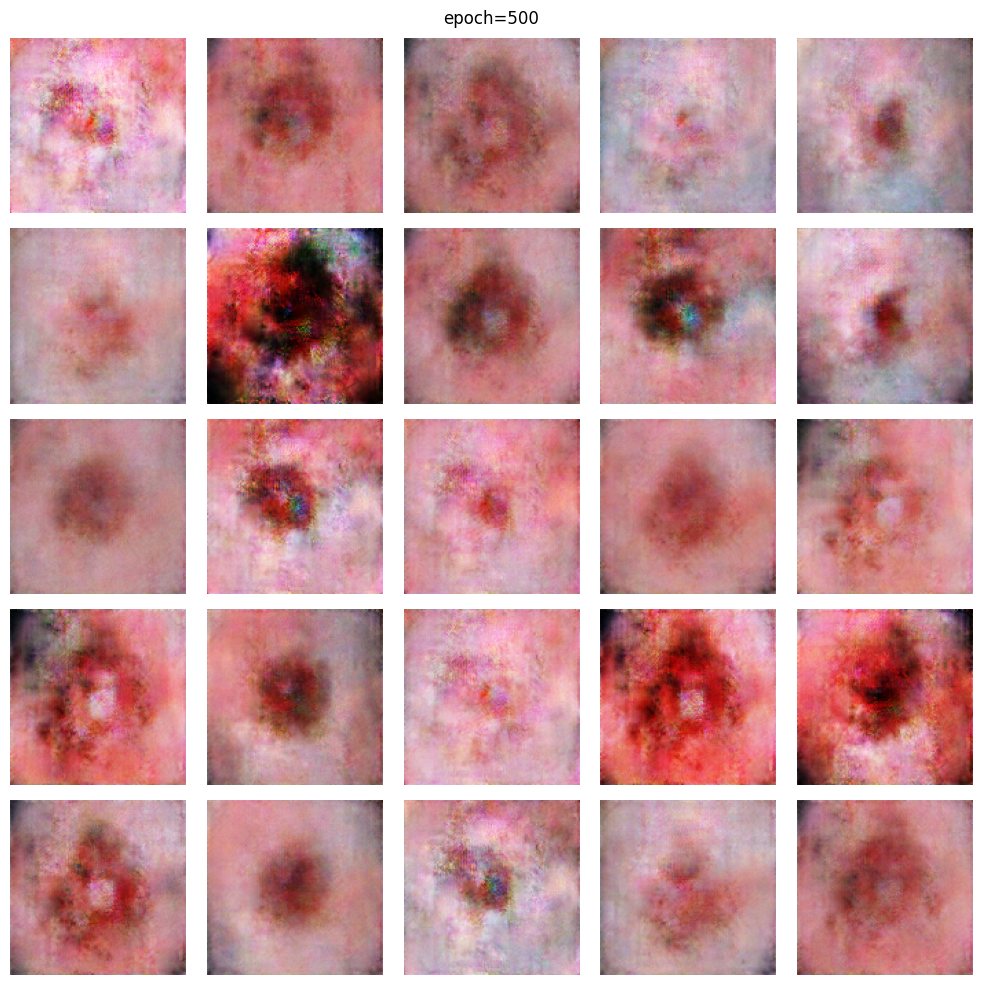

Running some more epochs...
Memory usage for GPU: 3.690 GB
Epoch: 550, D Loss: 0.596034586429596, G Loss: 0.5955971479415894
Running some more epochs...
Memory usage for GPU: 4.001 GB
Epoch: 600, D Loss: 0.6390355825424194, G Loss: 0.6383810043334961


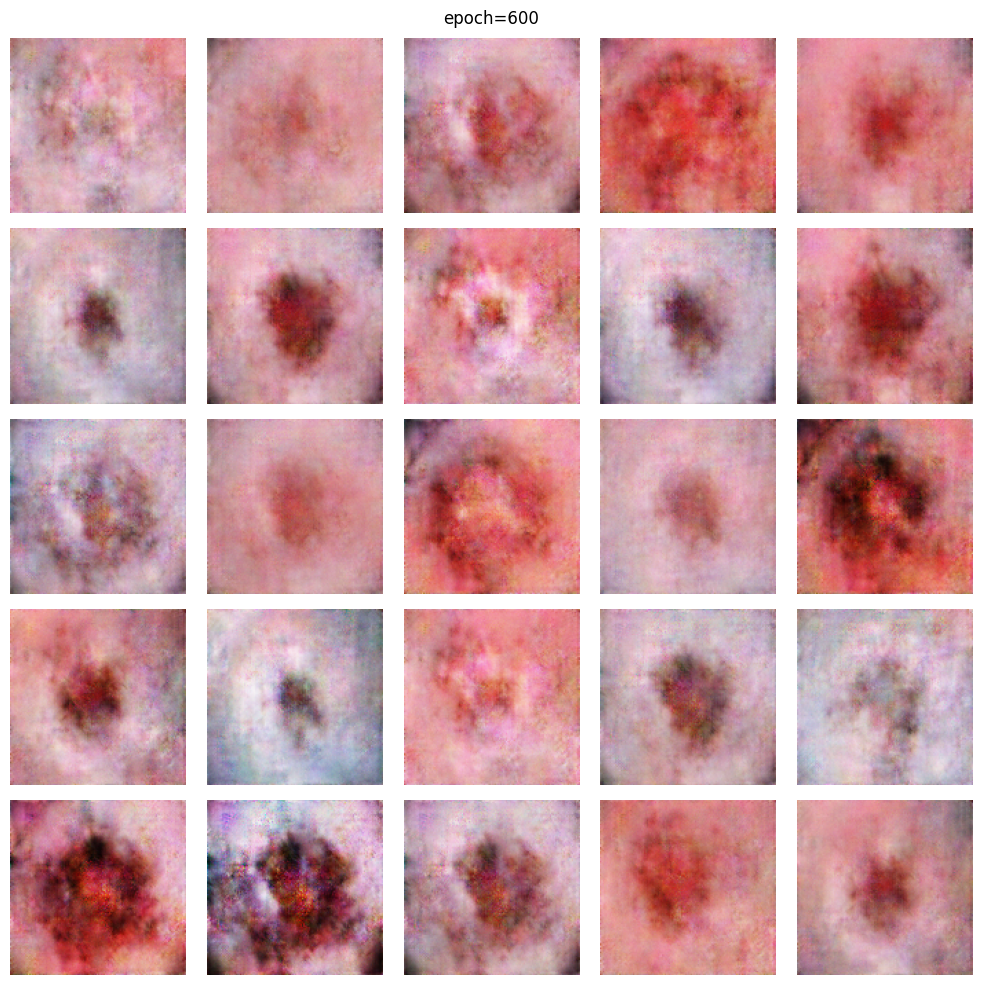

Running some more epochs...
Memory usage for GPU: 4.352 GB
Epoch: 650, D Loss: 0.6648104190826416, G Loss: 0.6644010543823242
Running some more epochs...
Memory usage for GPU: 4.663 GB
Epoch: 700, D Loss: 0.6812224388122559, G Loss: 0.6808139085769653


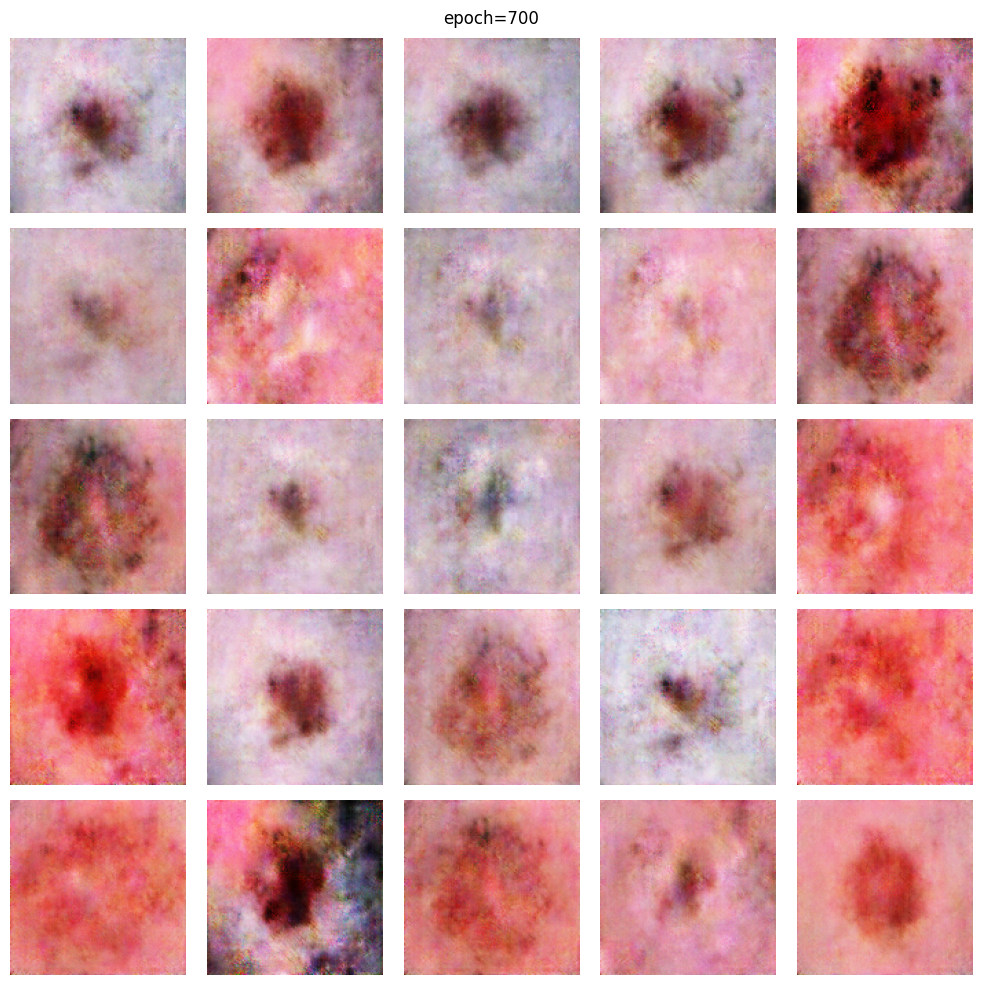

Running some more epochs...
Memory usage for GPU: 5.014 GB
Epoch: 750, D Loss: 0.6768535375595093, G Loss: 0.676594078540802
Running some more epochs...
Memory usage for GPU: 5.326 GB
Epoch: 800, D Loss: 0.679617166519165, G Loss: 0.6794099807739258


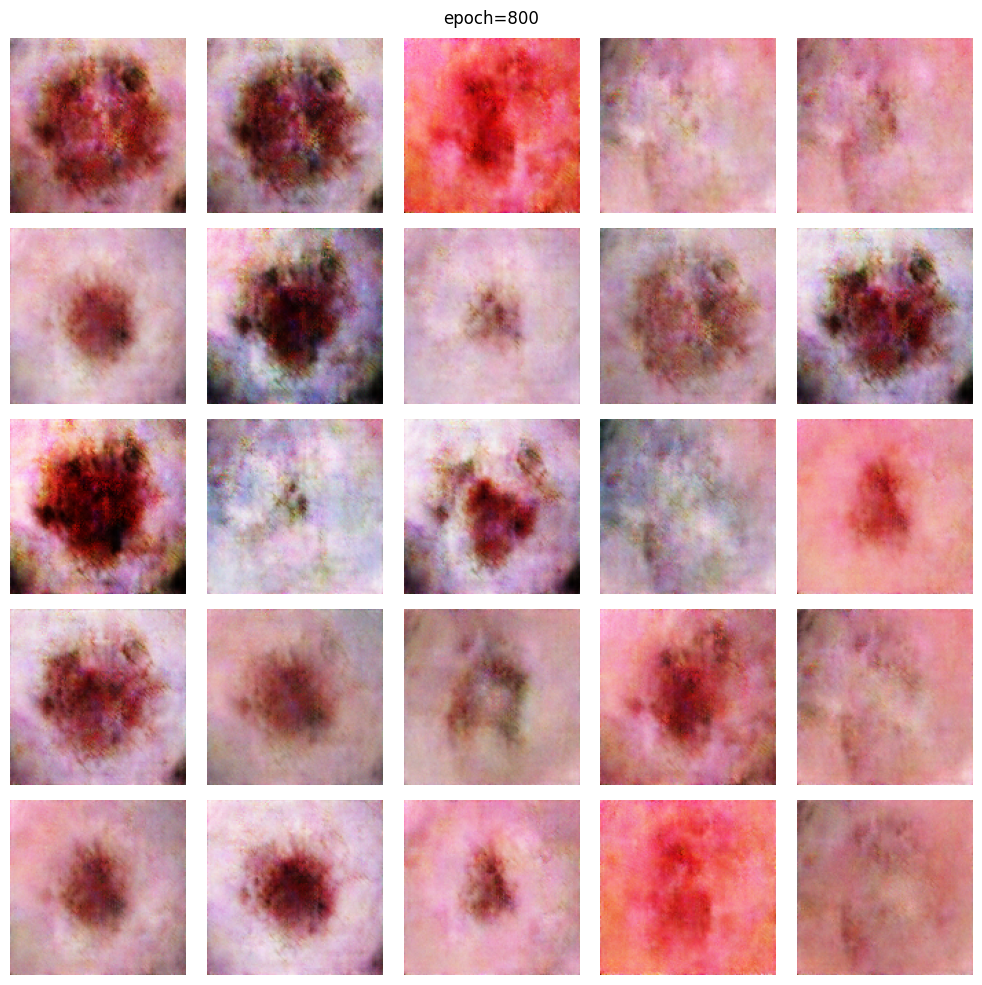

Running some more epochs...
Memory usage for GPU: 5.677 GB
Epoch: 850, D Loss: 0.668748140335083, G Loss: 0.6687366366386414
Running some more epochs...
Memory usage for GPU: 5.988 GB
Epoch: 900, D Loss: 0.6703909635543823, G Loss: 0.6700319647789001


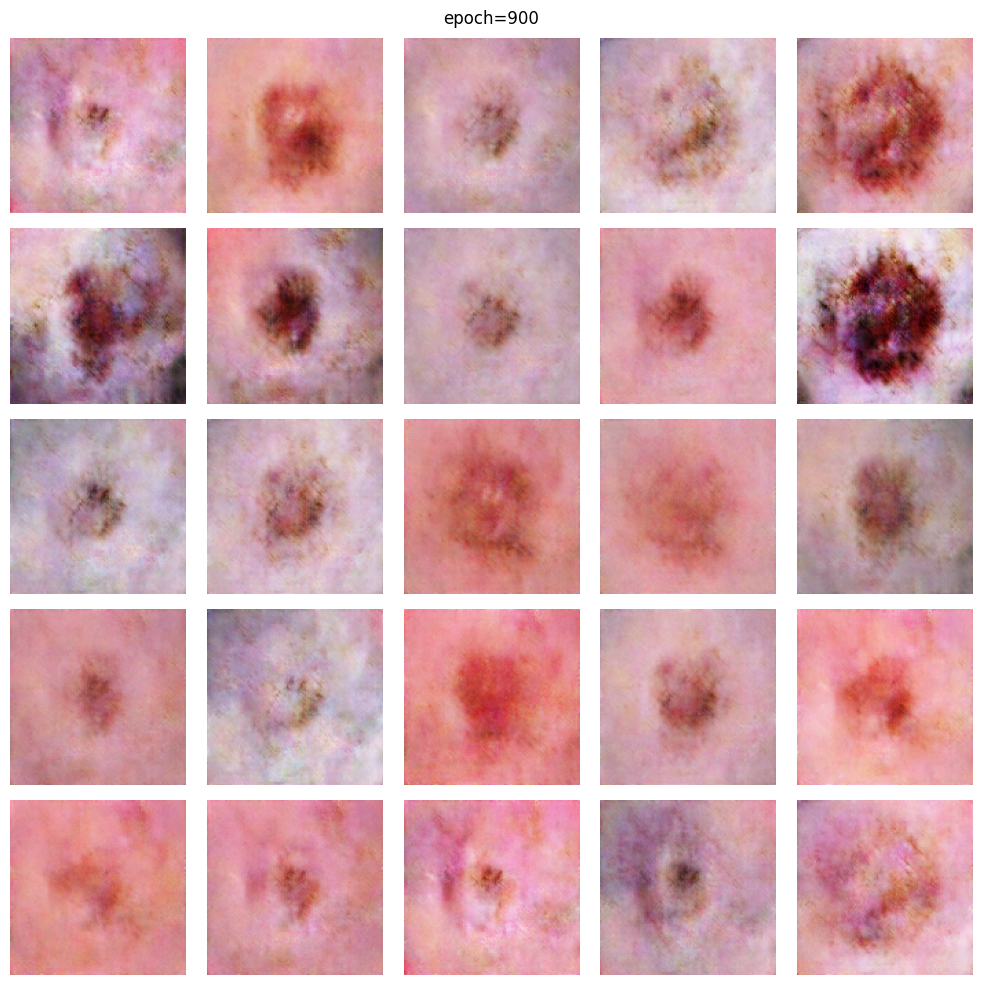

Running some more epochs...
Memory usage for GPU: 6.339 GB
Epoch: 950, D Loss: 0.6634325981140137, G Loss: 0.6636255979537964
Running some more epochs...
Memory usage for GPU: 6.649 GB
Epoch: 1000, D Loss: 0.6619623303413391, G Loss: 0.6618118286132812


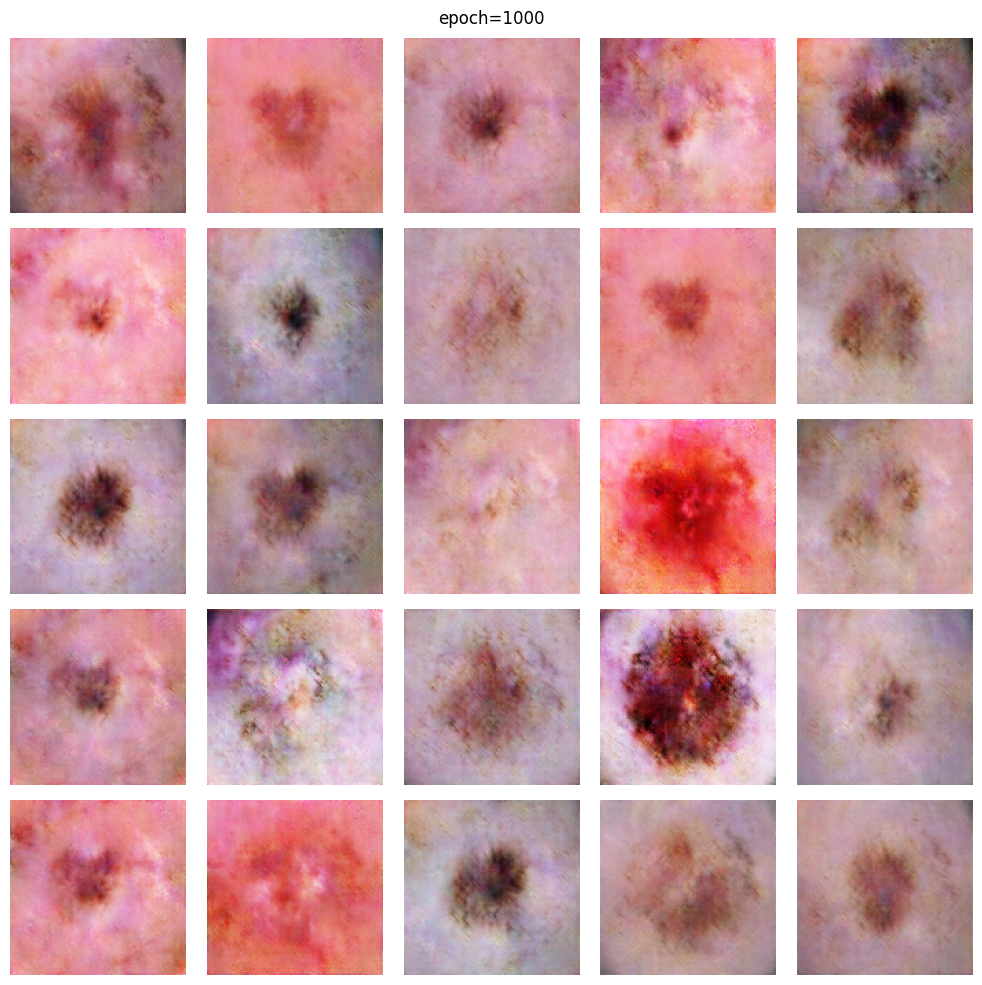

Running some more epochs...
Memory usage for GPU: 7.000 GB
Epoch: 1050, D Loss: 0.6519615054130554, G Loss: 0.6515193581581116
Running some more epochs...
Memory usage for GPU: 7.311 GB
Epoch: 1100, D Loss: 0.649170994758606, G Loss: 0.649036169052124


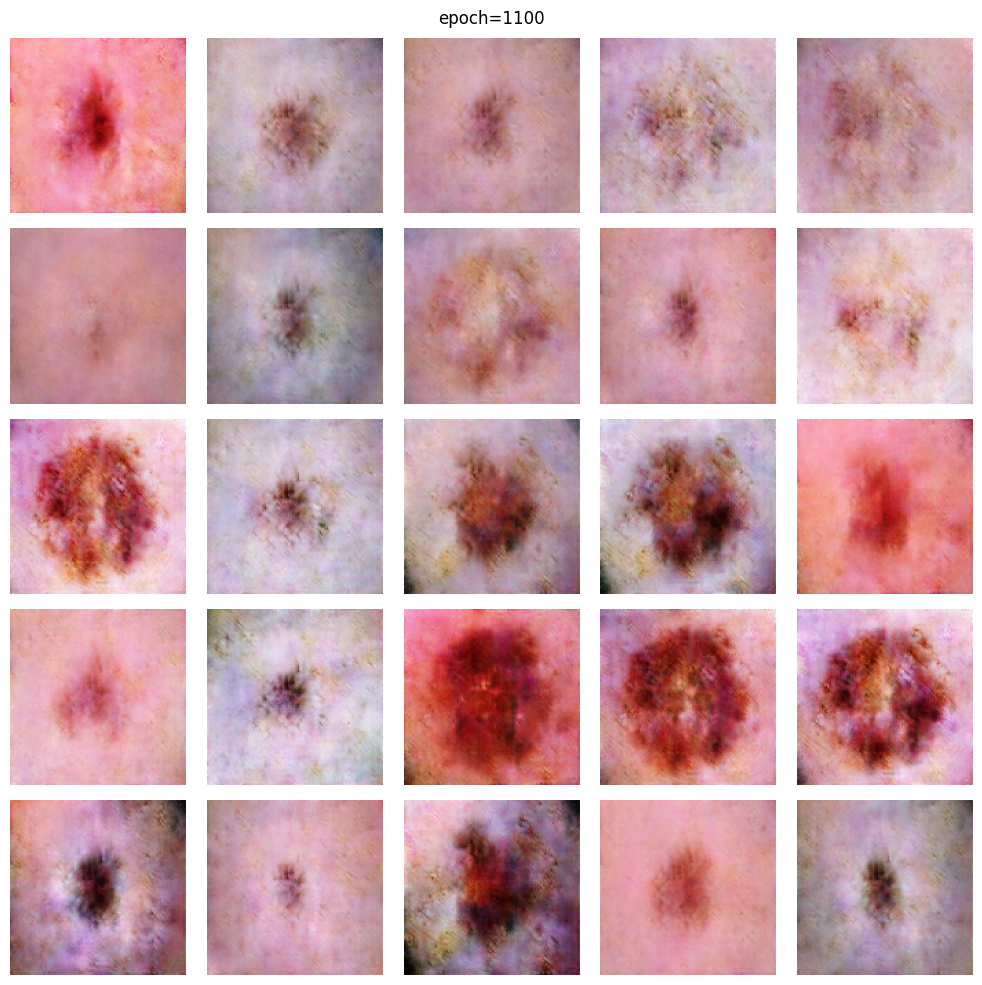

Running some more epochs...
Memory usage for GPU: 7.645 GB
Epoch: 1150, D Loss: 0.6461646556854248, G Loss: 0.6458898186683655
Running some more epochs...
Memory usage for GPU: 7.957 GB
Epoch: 1200, D Loss: 0.6411902904510498, G Loss: 0.6410544514656067


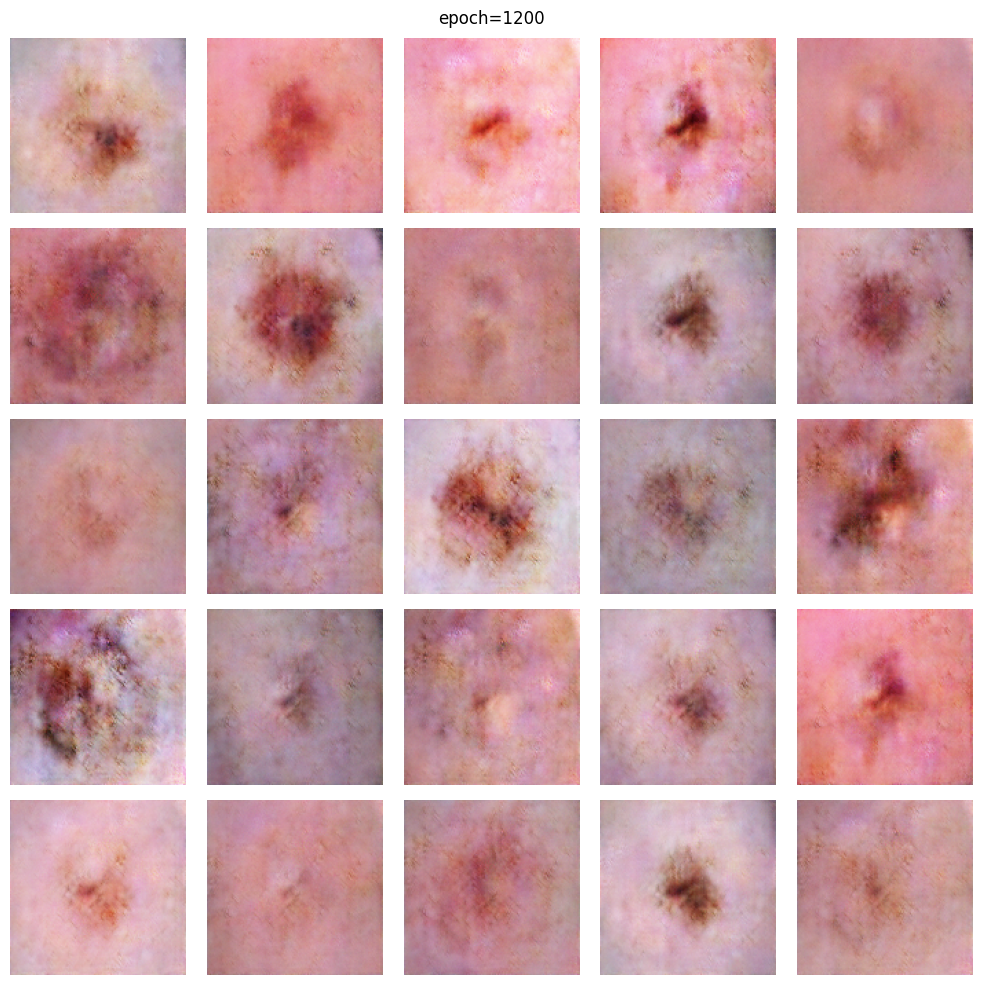

Running some more epochs...
Memory usage for GPU: 8.289 GB


In [13]:
train_gan(generator, discriminator, gan, epochs=1201, batch_size=32)

## Resultados finales luego de 1200 epochs

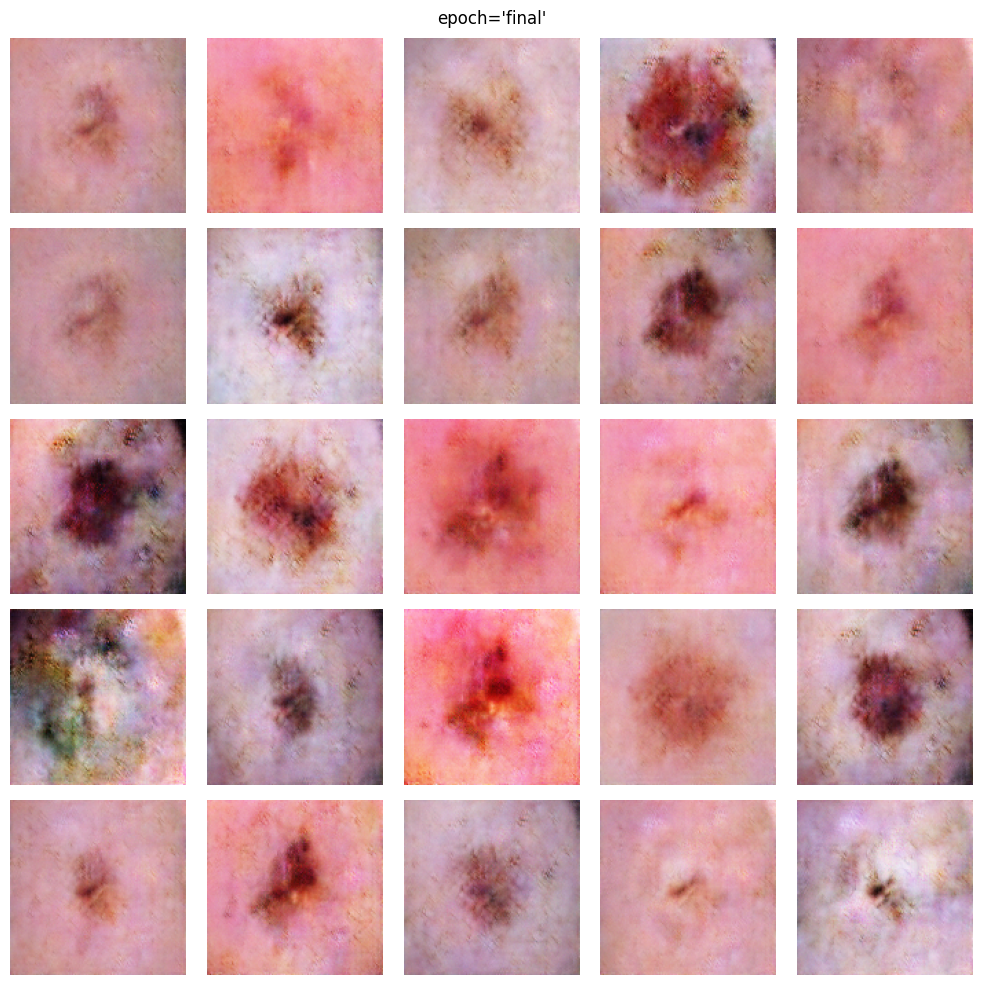

In [14]:
generator.load_weights('generator.weights.h5')
show_generated_images(generator, 'final')

## Evaluación de coeficiente de similitud estructual

*Observacion*: un análisis más exhaustivo de la SSIM requeriría promediar los resultados de muchas imágenes sintéticas comparadas con muchas imágenes reales. Esto se obvió debido a sus altos costos computacionales. Se muestran resultados preliminares en forma ilustrativa

In [19]:
real_image = cv2.imread('ISIC_0024336.jpg')
real_image = cv2.cvtColor(real_image, cv2.COLOR_BGR2RGB)
real_image = cv2.resize(real_image, (128, 128))
synthetic_image = cv2.imread('gan_figures/epoch_1200.png')

In [27]:
from skimage.metrics import structural_similarity as ssim
import pandas as pd

def compare_images(real_image, synthetic_image, extra_title_str=''):
    """
    Compare two images using SSIM and PSNR metrics
    """
    # Get metric
    ssim_score = ssim(real_image, synthetic_image, multichannel=True, channel_axis=-1)
    
    # Plot images side by side
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(real_image)
    axs[0].set_title('Real Image')
    axs[0].axis('off')
    axs[1].imshow(synthetic_image)
    axs[1].set_title('Synthetic Image')
    axs[1].axis('off')
    fig.suptitle(f'SSIM: {ssim_score:.3f}' + extra_title_str, fontsize=16, fontweight='bold')
    plt.show()

    return ssim_score

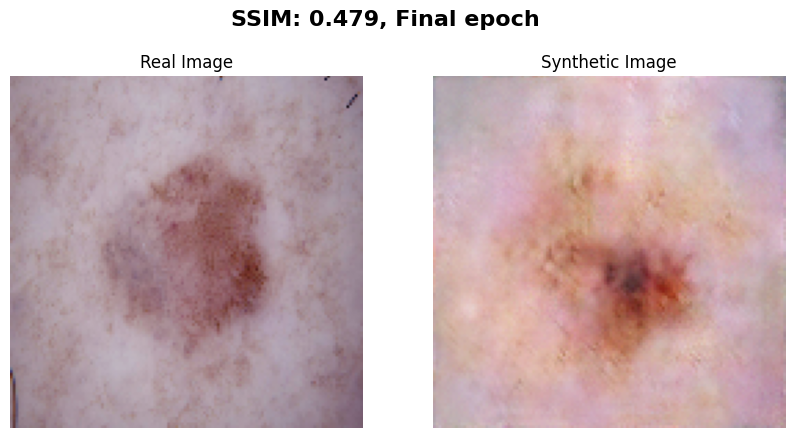

np.float64(0.47868941475828586)

In [31]:
compare_images(real_image, synthetic_image, extra_title_str=', Final epoch')

Como referencia, tomemos la similaridad para el ruido blanco de la primer epoch

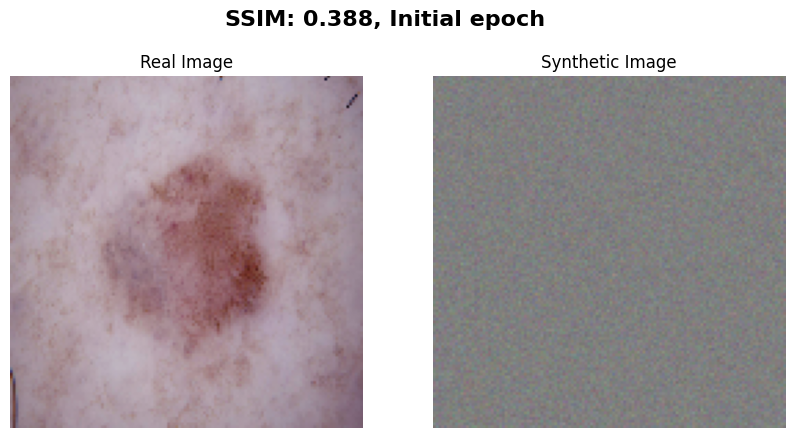

np.float64(0.387586151600837)

In [32]:
noisy_generation = cv2.imread('gan_figures/epoch_0.png')
compare_images(real_image, noisy_generation, extra_title_str=', Initial epoch')

Por último, veamos la evolución a lo largo de las epochs

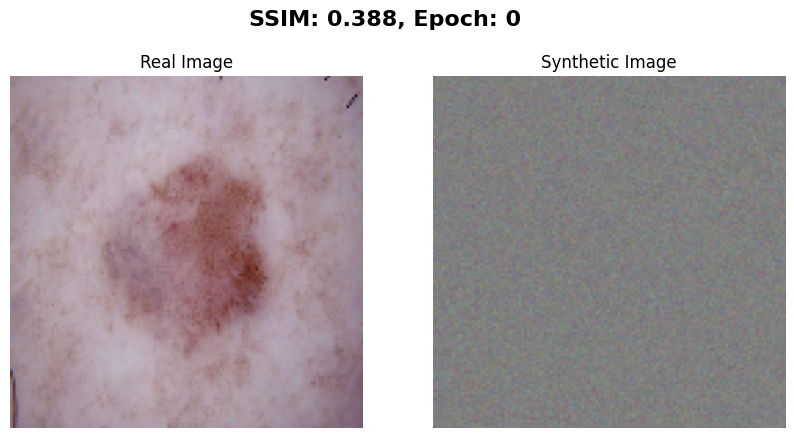

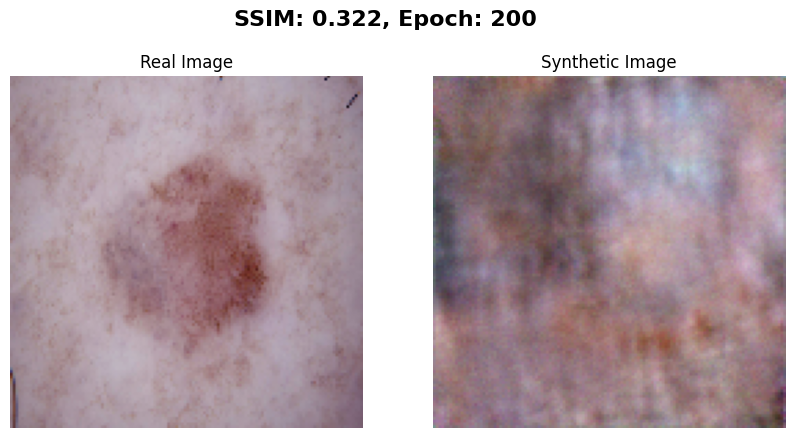

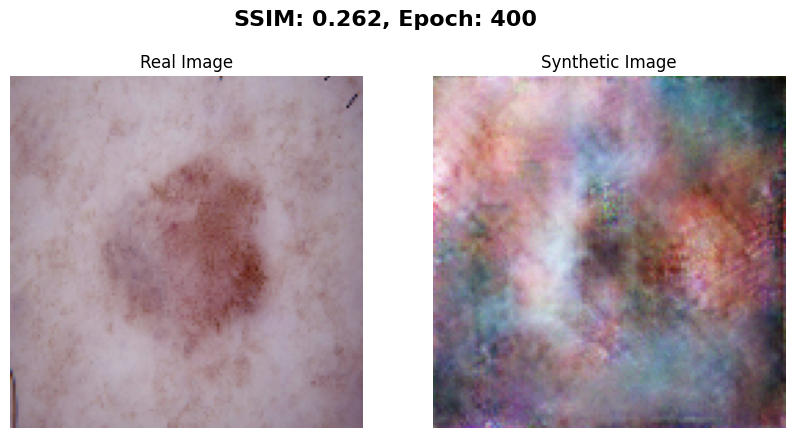

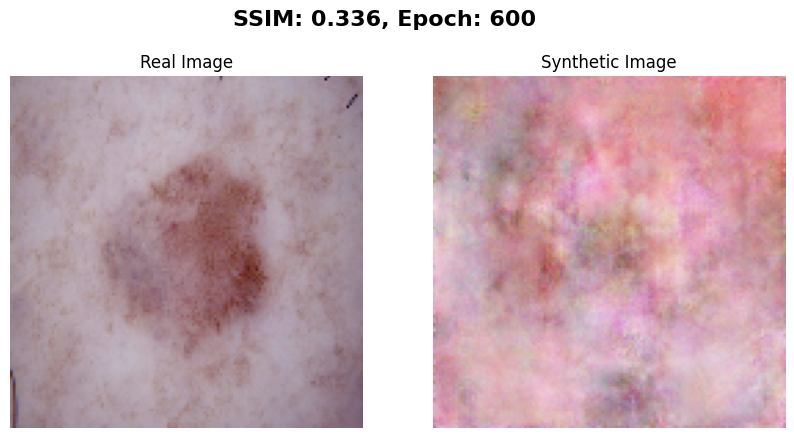

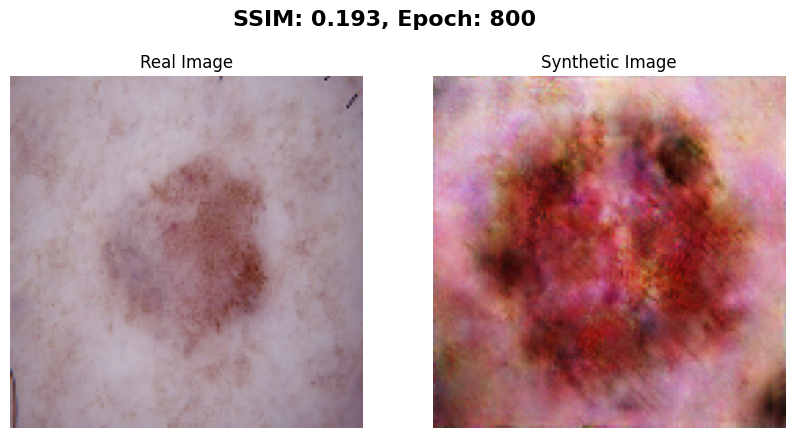

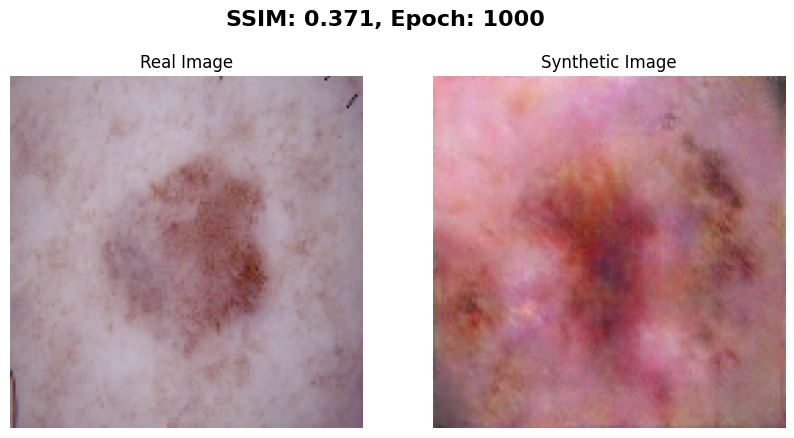

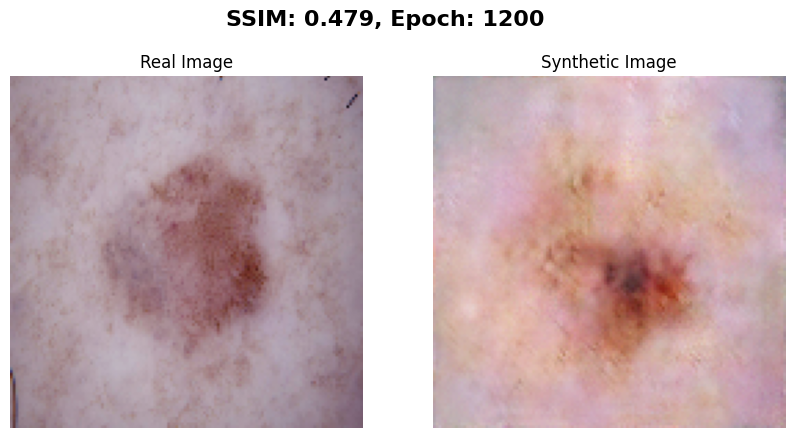

In [33]:
for i in range(0, 1201, 200):
    synthetic_image = cv2.imread(f'gan_figures/epoch_{i}.png')
    compare_images(real_image, synthetic_image, extra_title_str=f', Epoch: {i}')